In [1]:
import yt
import os
import time
import h5py
import numpy as np
import pyfftw as ft
import matplotlib
import matplotlib.pyplot as plt
import pyJHTDB
from pyJHTDB.dbinfo import isotropic1024coarse
from pyJHTDB import libJHTDB

In [2]:
N = 1024

In [3]:
w2 = ft.zeros_aligned((N,N,N), dtype='float32')

In [4]:
start = time.time()

folder = '/home/idies/workspace/scratch'

nproc = 8
nx = N//nproc

lw2 = ft.zeros_aligned((N//nproc,N,N), dtype='float32')

folder = '/home/idies/workspace/scratch'

for k in range(nproc):
    filename = 'ref-enstrophy-'+str(k)+'.npz'
    file = folder+'/'+filename
    
    content = np.load(file)
    lw2[:,:,:] = content['w2']
    
    w2[k*nx:(k+1)*nx,:,:] = lw2[:,:,:]
    
end = time.time()
print(end-start)

49.91804623603821


In [5]:
del lw2

In [6]:
start = time.time()

w2 = 0.5*w2

end = time.time()
print(end-start)

33.48290014266968


In [7]:
avgO = np.average(w2)
print(avgO)

249.218


In [8]:
chi = np.zeros((N,N,N))

chi[w2>10*avgO] = 1
chi = chi*w2

In [9]:
chisl = chi[0+64:128+64,0:128,0:128] + 0.05*avgO

In [10]:
data = dict(enstrophy = (chisl, "s**(-2)"))
bbox = np.array([[0,2*np.pi/8], [0,2*np.pi/8], [0,2*np.pi/8]])
ds = yt.load_uniform_grid(data, (128,128,128), length_unit="m", bbox=bbox, nprocs=8)

yt : [INFO     ] 2017-03-06 21:00:17,018 Parameters: current_time              = 0.0
yt : [INFO     ] 2017-03-06 21:00:17,031 Parameters: domain_dimensions         = [128 128 128]
yt : [INFO     ] 2017-03-06 21:00:17,041 Parameters: domain_left_edge          = [ 0.  0.  0.]
yt : [INFO     ] 2017-03-06 21:00:17,047 Parameters: domain_right_edge         = [ 0.78539816  0.78539816  0.78539816]
yt : [INFO     ] 2017-03-06 21:00:17,052 Parameters: cosmological_simulation   = 0.0


In [11]:
w2min = np.min(chisl)
w2max = np.max(chisl)

yt : [INFO     ] 2017-03-06 21:00:37,507 Rendering scene (Can take a while).
yt : [INFO     ] 2017-03-06 21:00:37,518 Creating volume
/home/idies/anaconda3/lib/python3.5/site-packages/yt/utilities/amr_kdtree/amr_kdtree.py:311: RuntimeWarning: invalid value encountered in log10
  dds.append(np.log10(vcd[field].astype('float64')))


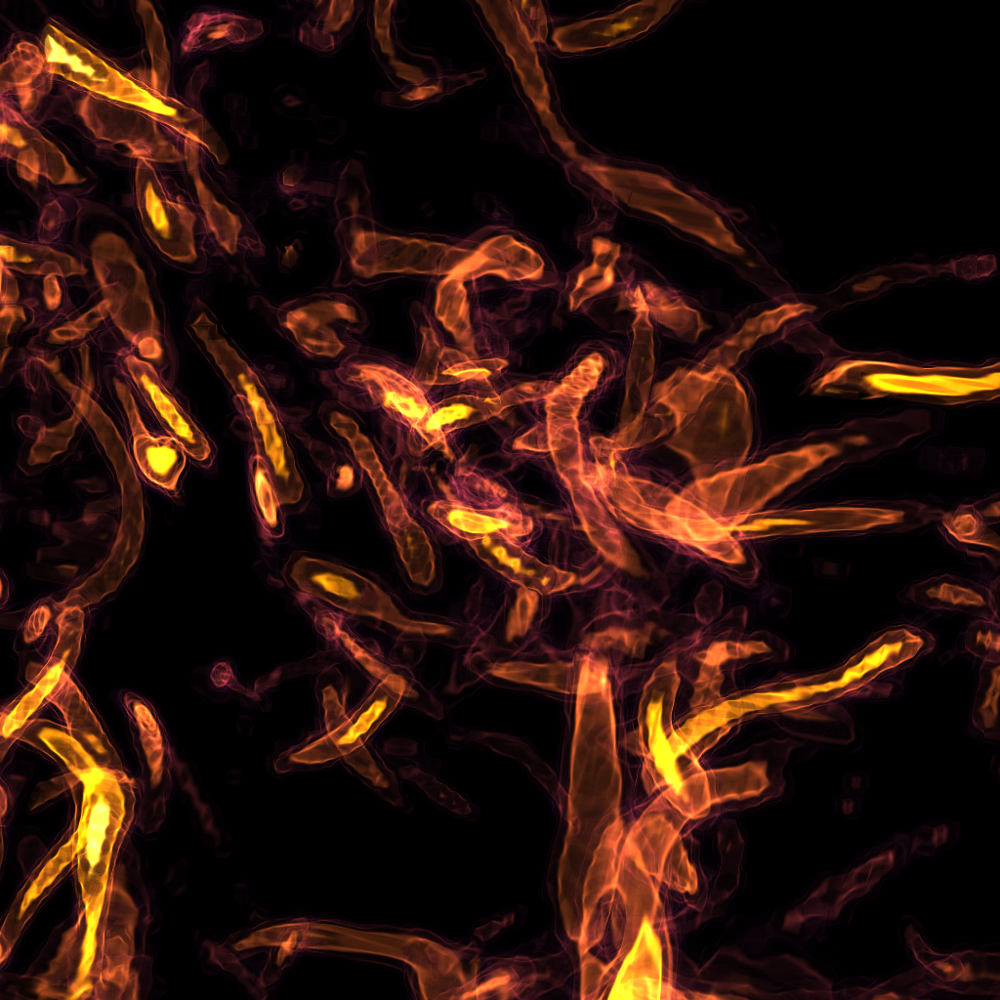

In [12]:
##############################################
### Create the base scene from the dataset ###
##############################################

sc = yt.create_scene(ds,'enstrophy', lens_type='perspective')

#############################################
### Camera, Focus and Orientation Options ###
#############################################

zom = 0.8
sc.camera.resolution = (1024, 1024)
sc.camera.set_position(np.array([-1.5*zom*(2*np.pi)/(8),1.5*zom*(2*np.pi)/(8),0.0])) 
sc.camera.set_focus(ds.domain_center) 
sc.camera.pitch(0.0)
sc.camera.yaw(0.0)
sc.camera.roll(0.35*np.pi/8)
sc.camera.zoom(2.8)

#########################################
### Transfer Function / Color Options ###
#########################################

source = sc[0]

tf = yt.ColorTransferFunction(np.log10((w2min,w2max)))
tf.add_layers(10, colormap='inferno')
source.tfh.tf = tf
source.tfh.bounds = (w2min,w2max)

source.tfh.set_log(True)
source.tfh.grey_opacity = False
source.tfh.plot('transfer_function.png',profile_field='enstrophy')

#######################################
### Showing and rendering the scene ###
#######################################

sc.show(sigma_clip=4.0)
#sc.save('enstrophy-rendering-0.png',sigma_clip=2.0)

In [ ]:
##############################################
### Create the base scene from the dataset ###
##############################################

sc = yt.create_scene(ds,'enstrophy', lens_type='perspective')

#############################################
### Camera, Focus and Orientation Options ###
#############################################

zom = 0.8
sc.camera.resolution = (1024, 1024)
sc.camera.set_position(np.array([-1.5*zom*(2*np.pi)/(8),1.5*zom*(2*np.pi)/(8),0.0])) 
sc.camera.set_focus(np.array([2*np.pi/16,2*np.pi/16,4*np.pi/16])) 
sc.camera.zoom(1.8)

#########################################
### Transfer Function / Color Options ###
#########################################

source = sc[0]

tf = yt.ColorTransferFunction(np.log10((w2min,w2max)))
tf.add_layers(10, colormap='inferno')
source.tfh.tf = tf
source.tfh.bounds = (w2min,w2max)

source.tfh.set_log(True)
source.tfh.grey_opacity = False
source.tfh.plot('transfer_function.png',profile_field='enstrophy')

#######################################
### Showing and rendering the scene ###
#######################################

sc.show(sigma_clip=4.0)
#sc.save('enstrophy-rendering-0.png',sigma_clip=2.0)

yt : [INFO     ] 2017-03-06 21:01:57,110 Rendering scene (Can take a while).
yt : [INFO     ] 2017-03-06 21:01:57,132 Creating volume
/home/idies/anaconda3/lib/python3.5/site-packages/yt/utilities/amr_kdtree/amr_kdtree.py:311: RuntimeWarning: invalid value encountered in log10
  dds.append(np.log10(vcd[field].astype('float64')))


In [27]:
from yt.visualization.volume_rendering.transfer_function_helper import TransferFunctionHelper
from yt.visualization.volume_rendering.api import Scene, VolumeSource

yt : [INFO     ] 2017-03-03 20:36:14,028 Rendering scene (Can take a while).
yt : [INFO     ] 2017-03-03 20:36:14,114 Creating volume
/home/idies/anaconda3/lib/python3.5/site-packages/yt/utilities/amr_kdtree/amr_kdtree.py:311: RuntimeWarning: invalid value encountered in log10
  dds.append(np.log10(vcd[field].astype('float64')))


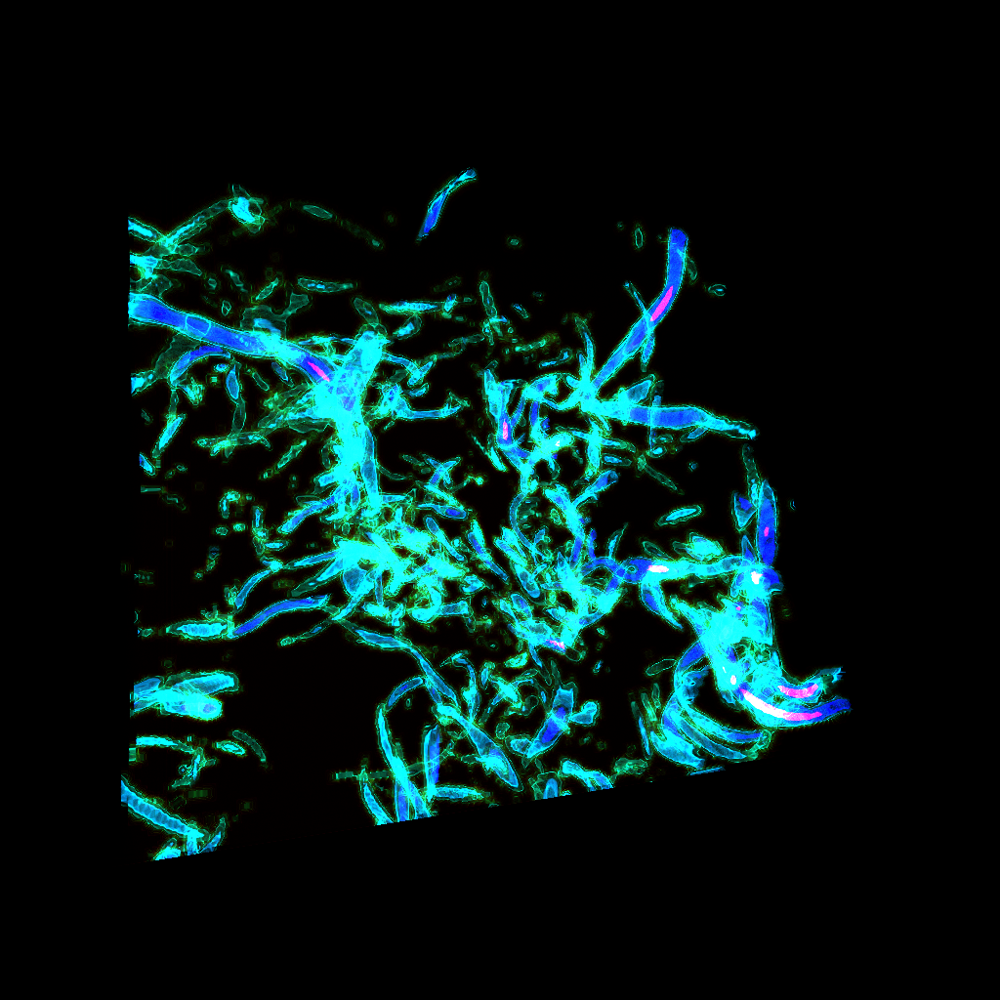

yt : [INFO     ] 2017-03-03 20:36:20,916 Rendering scene (Can take a while).
yt : [INFO     ] 2017-03-03 20:36:24,892 Saving render enstrophy-rendering-1.png


In [28]:
##############################################
### Create the base scene from the dataset ###
##############################################

sc = yt.create_scene(ds,'enstrophy', lens_type='perspective')

#############################################
### Camera, Focus and Orientation Options ###
#############################################

zom = 0.8
sc.camera.resolution = (1024, 1024)
sc.camera.set_focus(ds.domain_center) 
sc.camera.set_position(np.array([-1.5*zom*(2*np.pi)/(8),1.5*zom*(2*np.pi)/(8),0.0])) 

normal_vector = [1., 0., 0.]
north_vector = [0., 0., 1.]
sc.camera.switch_orientation(normal_vector=normal_vector,
                             north_vector=north_vector)
sc.camera.pitch(-np.pi/8)
sc.camera.yaw(-np.pi/8)
sc.camera.roll(0.0)#0.35*np.pi/8)#np.pi/8)
sc.camera.zoom(0.8)

#########################################
### Transfer Function / Color Options ###
#########################################

tfh = TransferFunctionHelper(ds)
tfh.set_field('enstrophy')
tfh.set_log(True)
tfh.set_bounds()
tfh.build_transfer_function()
tfh.tf.add_layers(10, colormap='gist_rainbow')

# Grab the first render source and set it to use the new transfer function
render_source = sc.get_source(0)
render_source.transfer_function = tfh.tf

#######################################
### Showing and rendering the scene ###
#######################################

sc.render()
sc.show(sigma_clip=1.0)
sc.save('enstrophy-rendering-1.png',sigma_clip=1.0)

yt : [INFO     ] 2017-03-03 20:36:28,090 Rendering scene (Can take a while).
yt : [INFO     ] 2017-03-03 20:36:28,507 Creating volume
/home/idies/anaconda3/lib/python3.5/site-packages/yt/utilities/amr_kdtree/amr_kdtree.py:311: RuntimeWarning: invalid value encountered in log10
  dds.append(np.log10(vcd[field].astype('float64')))


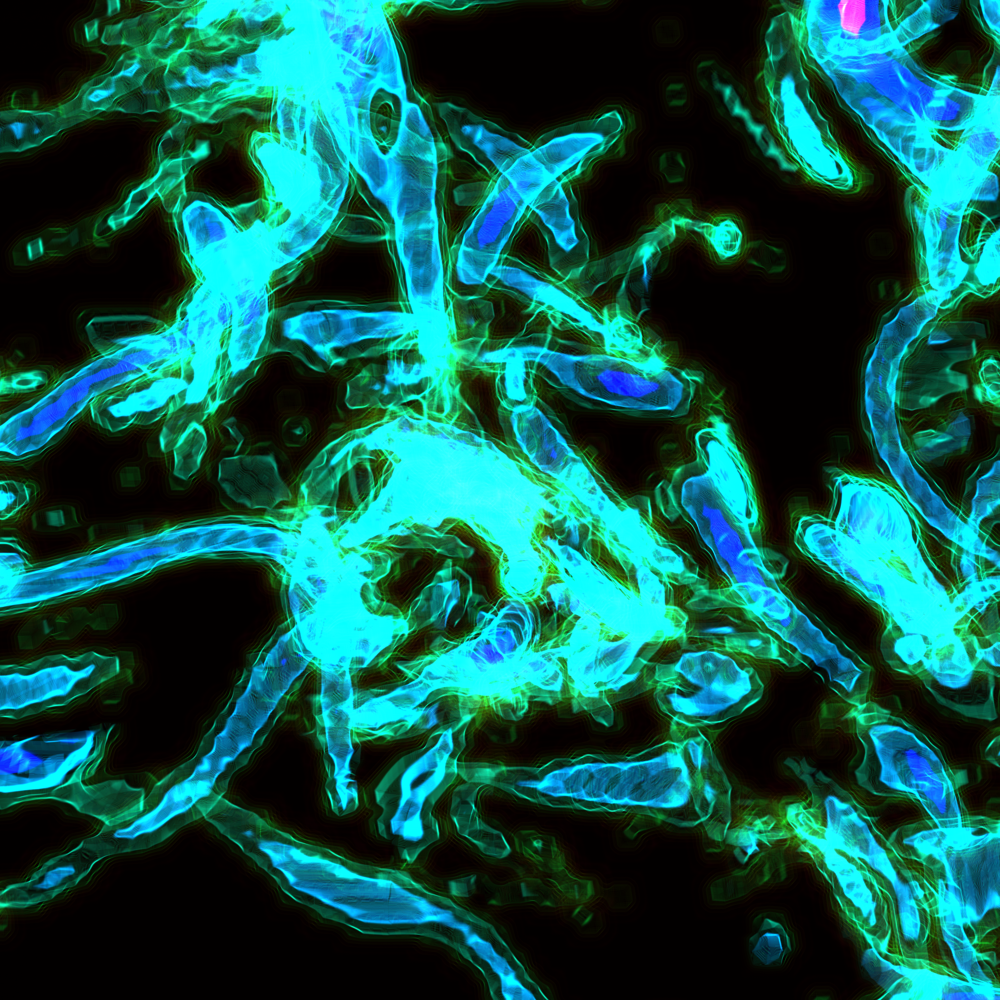

yt : [INFO     ] 2017-03-03 20:39:52,148 Rendering scene (Can take a while).
yt : [INFO     ] 2017-03-03 20:42:10,406 Saving render enstrophy-rendering-2.png


In [29]:
##############################################
### Create the base scene from the dataset ###
##############################################

sc = yt.create_scene(ds,'enstrophy', lens_type='plane-parallel')

#############################################
### Camera, Focus and Orientation Options ###
#############################################

zom = 0.8
sc.camera.resolution = (4*1024,4*1024)
sc.camera.set_focus(ds.domain_center) 
sc.camera.set_position(np.array([-1.5*zom*(2*np.pi)/(8),1.5*zom*(2*np.pi)/(8),0.0])) 

normal_vector = [1., 0., 0.]
north_vector = [0., 0., 1.]
sc.camera.switch_orientation(normal_vector=normal_vector,
                             north_vector=north_vector)
sc.camera.pitch(-np.pi/8)
sc.camera.yaw(-np.pi/8)
sc.camera.roll(0.0)#0.35*np.pi/8)#np.pi/8)
sc.camera.zoom(2.8)

#########################################
### Transfer Function / Color Options ###
#########################################

tfh = TransferFunctionHelper(ds)
tfh.set_field('enstrophy')
tfh.set_log(True)
tfh.set_bounds()
tfh.build_transfer_function()
tfh.tf.add_layers(10, colormap='gist_rainbow')

# Grab the first render source and set it to use the new transfer function
render_source = sc.get_source(0)
render_source.transfer_function = tfh.tf

#######################################
### Showing and rendering the scene ###
#######################################

sc.render()
sc.show(sigma_clip=1.0)
sc.save('enstrophy-rendering-2.png',sigma_clip=1.0)

yt : [INFO     ] 2017-03-03 20:43:20,432 Rendering scene (Can take a while).
yt : [INFO     ] 2017-03-03 20:43:20,549 Creating volume
/home/idies/anaconda3/lib/python3.5/site-packages/yt/utilities/amr_kdtree/amr_kdtree.py:311: RuntimeWarning: invalid value encountered in log10
  dds.append(np.log10(vcd[field].astype('float64')))


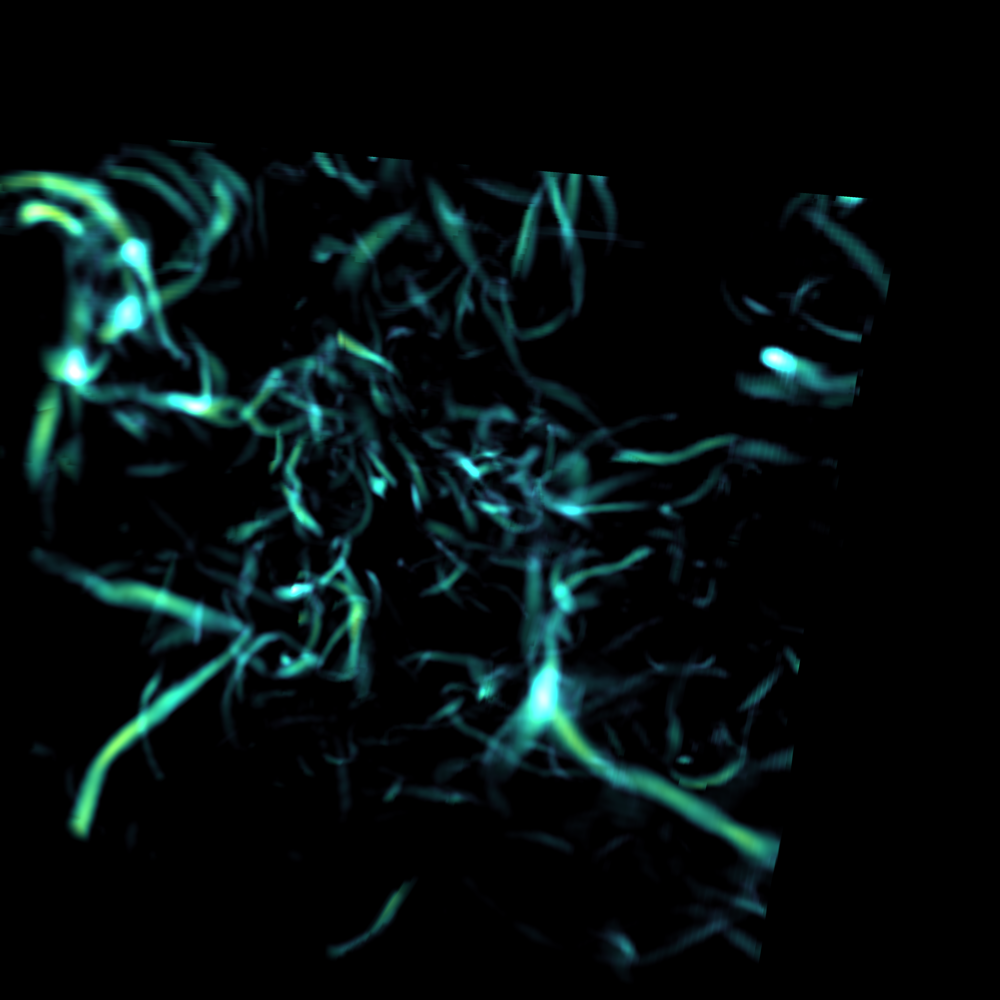

yt : [INFO     ] 2017-03-03 20:44:47,036 Rendering scene (Can take a while).
yt : [INFO     ] 2017-03-03 20:45:43,125 Saving render enstrophy-rendering-4.png


In [30]:
sc = yt.create_scene(ds,'enstrophy', lens_type='perspective')
#im, sc = yt.volume_render(ds, 'enstrophy', fname='rendering.png')

# Set the camera focus to a position that is offset from the center of
# the domain

zom = 0.8
sc.camera.resolution = (4*1024, 4*1024)
sc.camera.set_focus(ds.domain_center) 
sc.camera.set_position(np.array([-1.5*zom*(2*np.pi)/(8),1.5*zom*(2*np.pi)/(8),0.0])) 
sc.camera.pitch(0.0)
sc.camera.yaw(0.0)
sc.camera.roll(0.35*np.pi/8)#np.pi/8)

# Move the camera position to the other side of the dataset

source = sc[0]

bounds = (1*avgO,w2max)
tf = yt.ColorTransferFunction(np.log10(bounds))
def linramp(vals, minval, maxval):
    return (vals - vals.min())/(vals.max() - vals.min())

tf.map_to_colormap(np.log10(1*avgO), np.log10(w2max), colormap='viridis',
                   scale_func=linramp)
source.tfh.tf = tf
source.tfh.bounds = bounds

##
source.tfh.set_log(True)
source.tfh.grey_opacity = False
source.tfh.plot('transfer_function-viridis.png',profile_field='enstrophy')
#sc.save('enstrophy-rendering.png',sigma_clip=6.0)
sc.show(sigma_clip=4.0)
sc.save('enstrophy-rendering-4.png',sigma_clip=4.0)

yt : [INFO     ] 2017-03-03 20:53:00,986 Rendering scene (Can take a while).
yt : [INFO     ] 2017-03-03 20:53:01,012 Creating volume
/home/idies/anaconda3/lib/python3.5/site-packages/yt/utilities/amr_kdtree/amr_kdtree.py:311: RuntimeWarning: invalid value encountered in log10
  dds.append(np.log10(vcd[field].astype('float64')))


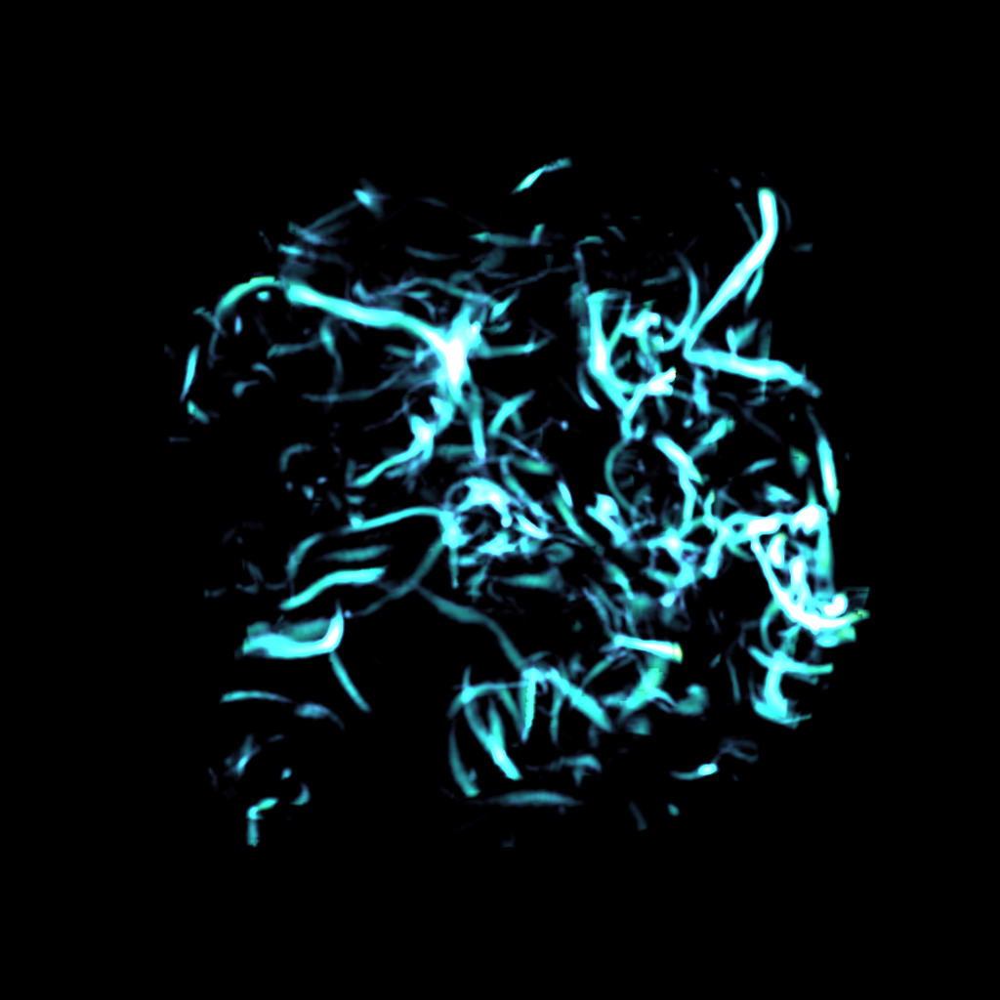

yt : [INFO     ] 2017-03-03 20:53:05,564 Rendering scene (Can take a while).
yt : [INFO     ] 2017-03-03 20:53:08,504 Saving render enstrophy-rendering-5.png


In [37]:
##############################################
### Create the base scene from the dataset ###
##############################################

sc = yt.create_scene(ds,'enstrophy', lens_type='plane-parallel')

#############################################
### Camera, Focus and Orientation Options ###
#############################################

zom = 0.8
sc.camera.resolution = (1*1024,1*1024)
sc.camera.set_focus(ds.domain_center) 
sc.camera.set_position(np.array([-1.5*zom*(2*np.pi)/(8),1.5*zom*(2*np.pi)/(8),0.0])) 

normal_vector = [1., 0., 0.]
north_vector = [0., 0., 1.]
sc.camera.switch_orientation(normal_vector=normal_vector,
                             north_vector=north_vector)
sc.camera.pitch(-np.pi/8)
sc.camera.yaw(-np.pi/8)
sc.camera.roll(0.0)#0.35*np.pi/8)#np.pi/8)
sc.camera.zoom(0.8)

#########################################
### Transfer Function / Color Options ###
#######################################
##
source = sc[0]

bounds = (1*avgO,w2max)
tf = yt.ColorTransferFunction(np.log10(bounds))
def linramp(vals, minval, maxval):
    return (vals - vals.min())/(vals.max() - vals.min())

tf.map_to_colormap(np.log10(1*avgO), np.log10(w2max), colormap='viridis',
                   scale_func=linramp)
source.tfh.tf = tf
source.tfh.bounds = bounds

##
source.tfh.set_log(True)
source.tfh.grey_opacity = False
source.tfh.plot('transfer_function-viridis.png',profile_field='enstrophy')

#######################################
### Showing and rendering the scene ###
#######################################

sc.render()
sc.show(sigma_clip=1.0)
sc.save('enstrophy-rendering-5.png',sigma_clip=1.0)